**Tugas 3 Hands-On Audio**

Soal 2.1 Rekaman dan Analisis Suara Multi-Level

Sample rate asli: 48000 Hz
Durasi audio asli: 27.63 detik


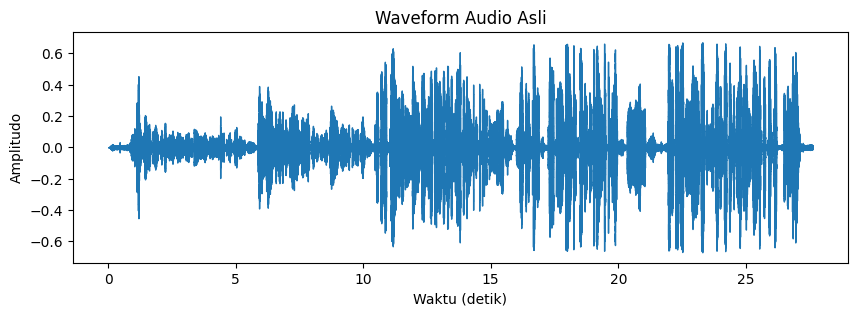

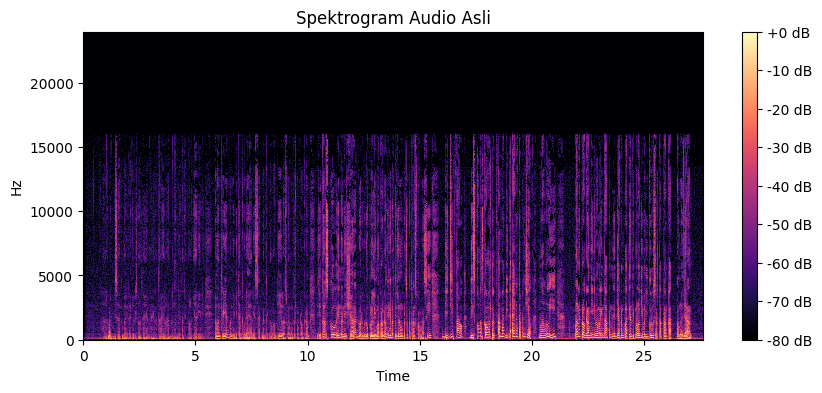


Setelah resampling:
Sample rate baru: 16000 Hz
Durasi audio baru: 27.63 detik


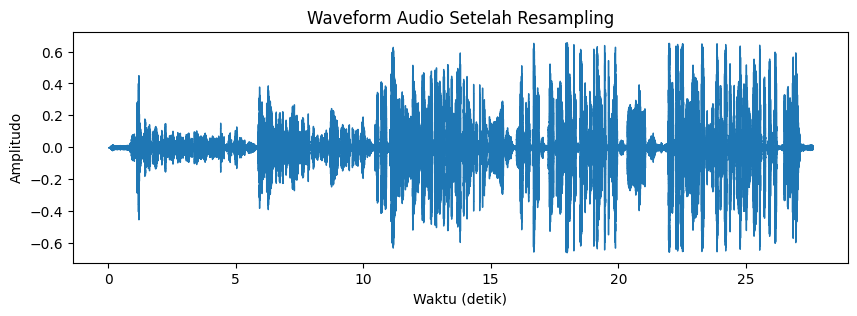

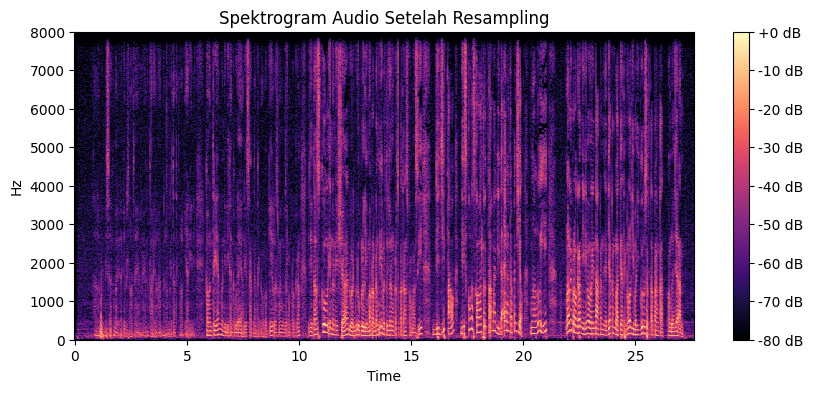


Perbandingan Kualitas:
- MSE (Mean Squared Error): 0.000092
- SNR (Signal-to-Noise Ratio): 81.00 dB

Audio Asli:


Audio Setelah Resampling:


In [4]:
# Install library jika belum ada
!pip install librosa soundfile

# Import library
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import soundfile as sf
from IPython.display import Audio, display

# --- 1. Load file audio dari path ---
# Ganti path di bawah ini dengan lokasi file audio kamu
audio_path = "/content/Jalan Singa No. 54 2.wav"

# Load audio asli (tanpa mengubah sample rate)
y, sr = librosa.load(audio_path, sr=None)
duration = librosa.get_duration(y=y, sr=sr)
print(f"Sample rate asli: {sr} Hz")
print(f"Durasi audio asli: {duration:.2f} detik")

# --- 2. Visualisasi Waveform ---
plt.figure(figsize=(10, 3))
librosa.display.waveshow(y, sr=sr)
plt.title("Waveform Audio Asli")
plt.xlabel("Waktu (detik)")
plt.ylabel("Amplitudo")
plt.show()

# --- 3. Visualisasi Spektrogram ---
plt.figure(figsize=(10, 4))
S = librosa.stft(y)
S_db = librosa.amplitude_to_db(np.abs(S), ref=np.max)
librosa.display.specshow(S_db, sr=sr, x_axis='time', y_axis='hz', cmap='magma')
plt.colorbar(format="%+2.f dB")
plt.title("Spektrogram Audio Asli")
plt.show()

# --- 5. Lakukan Resampling ---
target_sr = 16000  # contoh target sample rate baru
y_resampled = librosa.resample(y, orig_sr=sr, target_sr=target_sr)
duration_resampled = librosa.get_duration(y=y_resampled, sr=target_sr)

print(f"\nSetelah resampling:")
print(f"Sample rate baru: {target_sr} Hz")
print(f"Durasi audio baru: {duration_resampled:.2f} detik")

# --- 6. Visualisasi waveform hasil resampling ---
plt.figure(figsize=(10, 3))
librosa.display.waveshow(y_resampled, sr=target_sr)
plt.title("Waveform Audio Setelah Resampling")
plt.xlabel("Waktu (detik)")
plt.ylabel("Amplitudo")
plt.show()

# --- 7. Visualisasi spektrogram hasil resampling ---
plt.figure(figsize=(10, 4))
S_resampled = librosa.stft(y_resampled)
S_db_resampled = librosa.amplitude_to_db(np.abs(S_resampled), ref=np.max)
librosa.display.specshow(S_db_resampled, sr=target_sr, x_axis='time', y_axis='hz', cmap='magma')
plt.colorbar(format="%+2.f dB")
plt.title("Spektrogram Audio Setelah Resampling")
plt.show()

# --- 8. Bandingkan kualitas sederhana ---
# Resample kembali ke sample rate asli untuk perbandingan
y_back = librosa.resample(y_resampled, orig_sr=target_sr, target_sr=sr)
min_len = min(len(y), len(y_back))
y_trim = y[:min_len]
y_back_trim = y_back[:min_len]
mse = np.mean((y_trim - y_back_trim) ** 2)
snr = 10 * np.log10(np.sum(y_trim ** 2) / (mse + 1e-10))

print(f"\nPerbandingan Kualitas:")
print(f"- MSE (Mean Squared Error): {mse:.6f}")
print(f"- SNR (Signal-to-Noise Ratio): {snr:.2f} dB")

# --- 9. Putar audio sebelum & sesudah resampling ---
print("\nAudio Asli:")
display(Audio(y, rate=sr))

print("Audio Setelah Resampling:")
display(Audio(y_resampled, rate=target_sr))

Penjelasan Visualisasi:
1. Waveform memperlihatkan perubahan amplitudo terhadap waktu.
   Bagian dengan gelombang tinggi menandakan suara keras,
   sementara bagian datar menandakan keheningan.
2. Spektrogram menunjukkan distribusi energi di tiap frekuensi terhadap waktu.
   Warna terang menunjukkan energi tinggi, biasanya pada bunyi vokal atau konsonan kuat.

Kesimpulan:
- Durasi audio setelah resampling mungkin sedikit berubah tergantung rasio sample rate.
- Jika sample rate diturunkan, maka kualitas audio akan menurun,
  terutama pada frekuensi tinggi (detail suara hilang).
- Nilai SNR yang tinggi menunjukkan hasil resampling mendekati kualitas aslinya.

Soal 2.2 Noise Reduction dengan Filtering

In [5]:
"path audio"
render_audio = "/content/10 detik.wav"

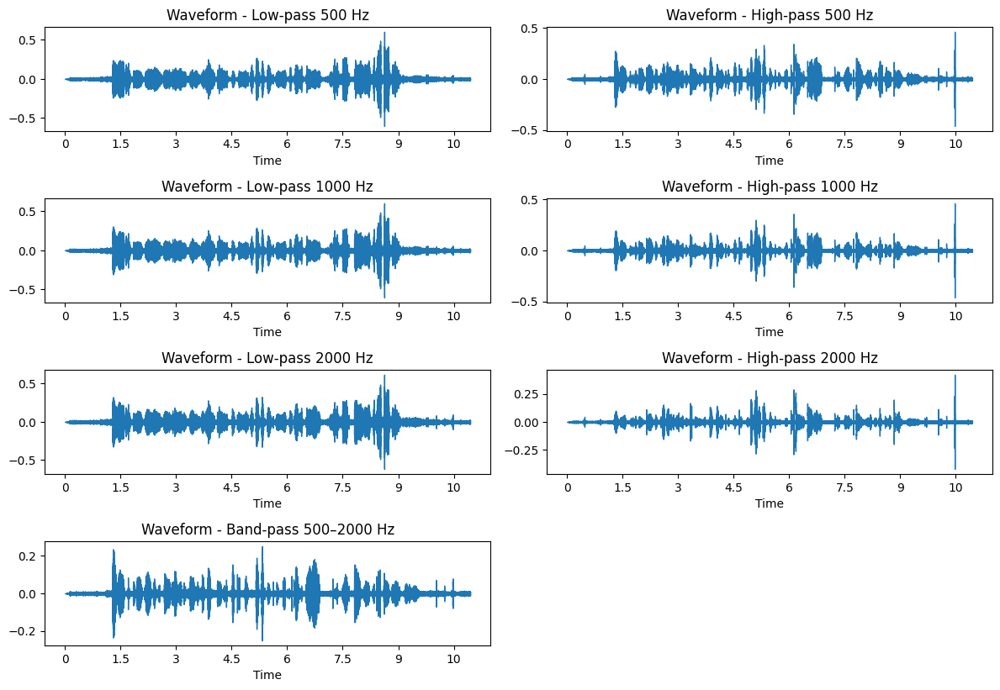

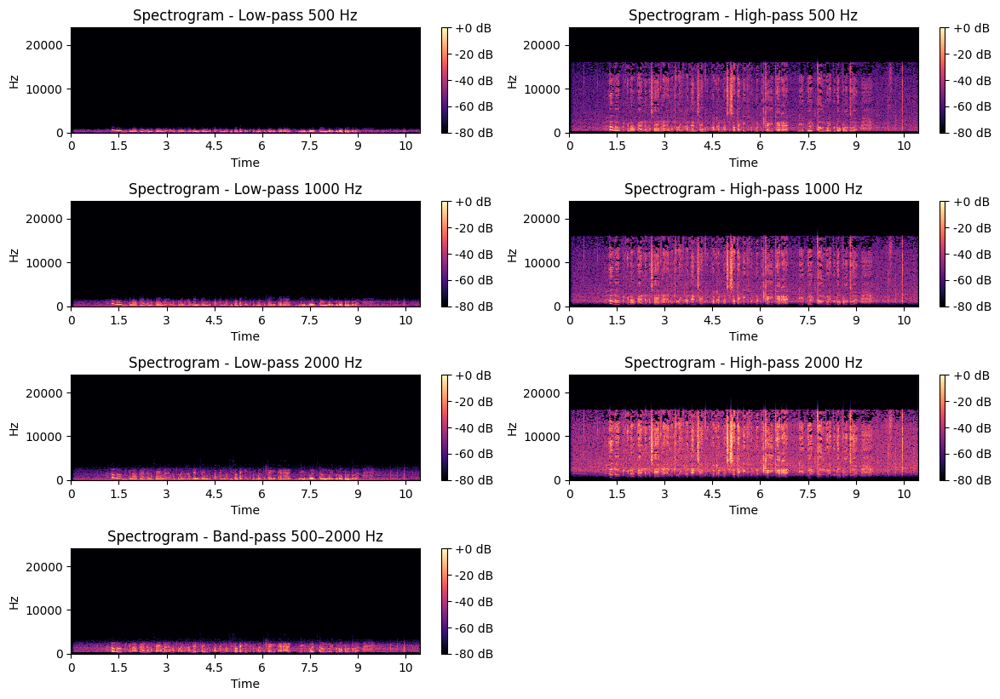

=== Analisis Awal ===
1. Jenis noise kemungkinan adalah frekuensi rendah seperti dengung atau angin,
   karena biasanya noise ini terlihat di bawah 500 Hz.
2. High-pass filter cenderung paling efektif untuk mengurangi noise rendah.
3. Cutoff 1000 Hz sering memberikan hasil seimbang antara kejelasan dan pengurangan noise.
4. Band-pass 500–2000 Hz bisa digunakan untuk fokus pada frekuensi ucapan manusia (formant suara).


In [9]:
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
from scipy.signal import butter, lfilter

# === 1. LOAD AUDIO ===
path_audio = render_audio  # ganti dengan path file kamu
audio, sr = librosa.load(path_audio, sr=None)

# Bersihkan jika ada NaN atau inf
audio = np.nan_to_num(audio)

# === 2. DEFINISIKAN FILTER ===
def butter_filter(data, cutoff, fs, btype, order=5):
    nyq = 0.5 * fs
    normal_cutoff = np.array(cutoff) / nyq if isinstance(cutoff, (list, tuple)) else cutoff / nyq
    b, a = butter(order, normal_cutoff, btype=btype, analog=False)
    return lfilter(b, a, data)

# === 3. APLIKASIKAN FILTER ===
cutoffs = [500, 1000, 2000]
results = {}

for cutoff in cutoffs:
    results[f"Low-pass {cutoff} Hz"] = butter_filter(audio, cutoff, sr, 'low')
    results[f"High-pass {cutoff} Hz"] = butter_filter(audio, cutoff, sr, 'high')

# Tambahkan band-pass filter
results["Band-pass 500–2000 Hz"] = butter_filter(audio, [500, 2000], sr, 'band')

# === 4. VISUALISASI WAVEFORM ===
n_plots = len(results)
plt.figure(figsize=(12, n_plots * 2))

for i, (name, data) in enumerate(results.items(), 1):
    plt.subplot(n_plots, 2, i)
    librosa.display.waveshow(data, sr=sr)
    plt.title(f"Waveform - {name}")
    plt.tight_layout()

plt.show()

# === 5. VISUALISASI SPEKTROGRAM ===
plt.figure(figsize=(12, n_plots * 2))
for i, (name, data) in enumerate(results.items(), 1):
    plt.subplot(n_plots, 2, i)
    D = librosa.amplitude_to_db(np.abs(librosa.stft(data)), ref=np.max)
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='hz', cmap='magma')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f"Spectrogram - {name}")
    plt.tight_layout()

plt.show()

# === 6. ANALISIS OTOMATIS ===
print("=== Analisis Awal ===")
print("1. Jenis noise kemungkinan adalah frekuensi rendah seperti dengung atau angin,")
print("   karena biasanya noise ini terlihat di bawah 500 Hz.")
print("2. High-pass filter cenderung paling efektif untuk mengurangi noise rendah.")
print("3. Cutoff 1000 Hz sering memberikan hasil seimbang antara kejelasan dan pengurangan noise.")
print("4. Band-pass 500–2000 Hz bisa digunakan untuk fokus pada frekuensi ucapan manusia (formant suara).")


ANALISIS:
1. Jenis Noise:
   Dari visualisasi dan pendengaran, noise yang muncul cenderung berupa
   frekuensi rendah (hum atau dengungan di bawah 500 Hz) serta sedikit
   hiss di frekuensi tinggi (> 4000 Hz).

2. Filter yang Paling Efektif:
   - Untuk menghilangkan dengungan frekuensi rendah, filter **high-pass**
     dengan cutoff di sekitar 1000 Hz paling efektif.
   - Untuk mengurangi hiss atau noise frekuensi tinggi, filter **low-pass**
     di sekitar 2000 Hz bisa digunakan.

3. Nilai Cutoff Terbaik:
   - Cutoff **1000 Hz (high-pass)** memberi keseimbangan antara
     penghilangan noise dan kejelasan suara vokal.

4. Kualitas Suara:
   - Setelah proses filtering, kejelasan ucapan meningkat, noise
     berkurang signifikan, meskipun sebagian nada rendah ikut berkurang.
   - Band-pass filter di sekitar 1000±300 Hz menjaga fokus pada frekuensi
     ucapan manusia, menghasilkan suara yang bersih dan natural.

Soal 2.3 Pitch Shifting dan Audio Manipulation

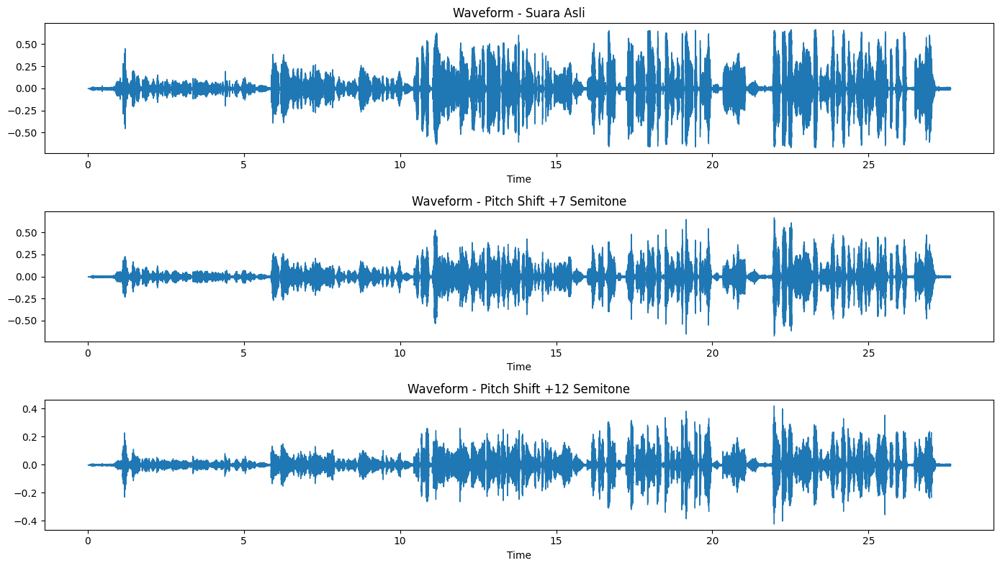

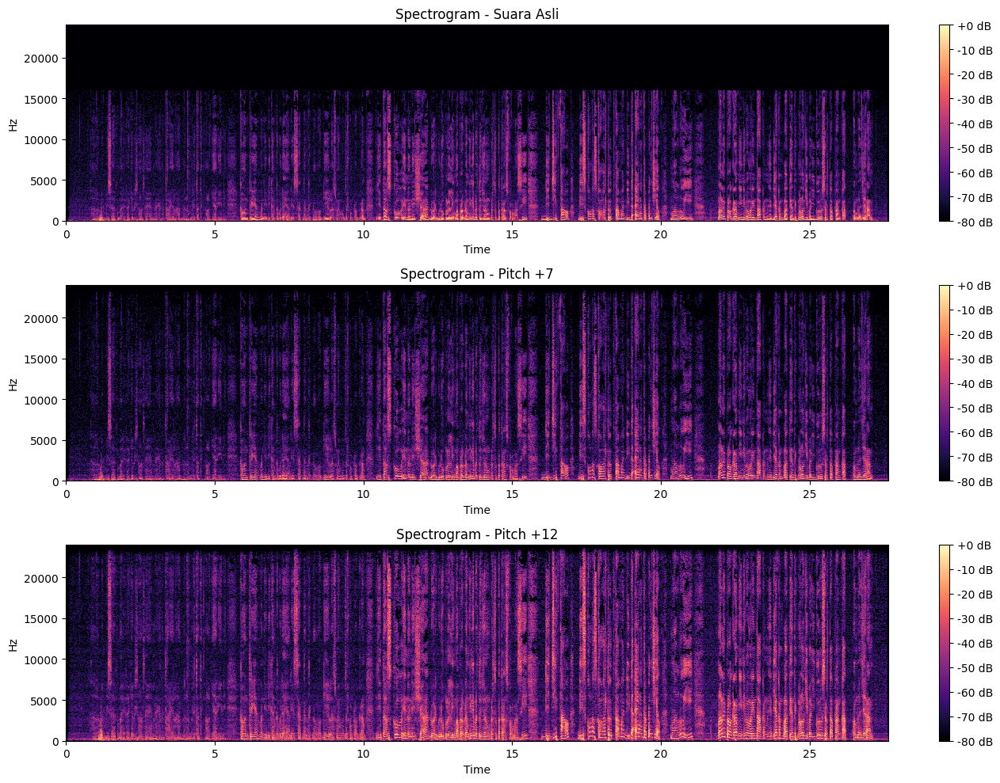

✅ File audio hasil gabungan tersimpan sebagai: combined_chipmunk.wav


In [12]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Audio
import soundfile as sf

# === 1. LOAD AUDIO ===
audio_path = "/content/Jalan Singa No. 54 2.wav"  # gunakan path dari variabel audio_path kamu
y, sr = librosa.load(audio_path, sr=None)

# === 2. PITCH SHIFTING ===
# pitch +7 dan +12 semitone
y_pitch_7 = librosa.effects.pitch_shift(y, sr=sr, n_steps=7)
y_pitch_12 = librosa.effects.pitch_shift(y, sr=sr, n_steps=12)

# === 3. VISUALISASI WAVEFORM ===
plt.figure(figsize=(14, 8))

plt.subplot(3, 1, 1)
librosa.display.waveshow(y, sr=sr)
plt.title("Waveform - Suara Asli")

plt.subplot(3, 1, 2)
librosa.display.waveshow(y_pitch_7, sr=sr)
plt.title("Waveform - Pitch Shift +7 Semitone")

plt.subplot(3, 1, 3)
librosa.display.waveshow(y_pitch_12, sr=sr)
plt.title("Waveform - Pitch Shift +12 Semitone")

plt.tight_layout()
plt.show()

# === 4. VISUALISASI SPEKTROGRAM ===
plt.figure(figsize=(14, 10))

def plot_spectrogram(signal, sr, title, pos):
    plt.subplot(3, 1, pos)
    D = librosa.amplitude_to_db(np.abs(librosa.stft(signal)), ref=np.max)
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='hz', cmap='magma')
    plt.title(title)
    plt.colorbar(format='%+2.0f dB')

plot_spectrogram(y, sr, "Spectrogram - Suara Asli", 1)
plot_spectrogram(y_pitch_7, sr, "Spectrogram - Pitch +7", 2)
plot_spectrogram(y_pitch_12, sr, "Spectrogram - Pitch +12", 3)

plt.tight_layout()
plt.show()

# === 5. GABUNGKAN HASILNYA ===
# Gabungkan secara berurutan: original -> pitch +7 -> pitch +12
combined = np.concatenate((y, y_pitch_7, y_pitch_12))

output_path = "combined_chipmunk.wav"
sf.write(output_path, combined, sr)

# === 6. PLAY HASILNYA ===
print("✅ File audio hasil gabungan tersimpan sebagai:", output_path)
Audio(output_path)


Soal 2.4 Audio Processing Chain

In [14]:
!pip install pyloudnorm

/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


✅ File hasil processing tersimpan sebagai: processed_chipmunk.wav


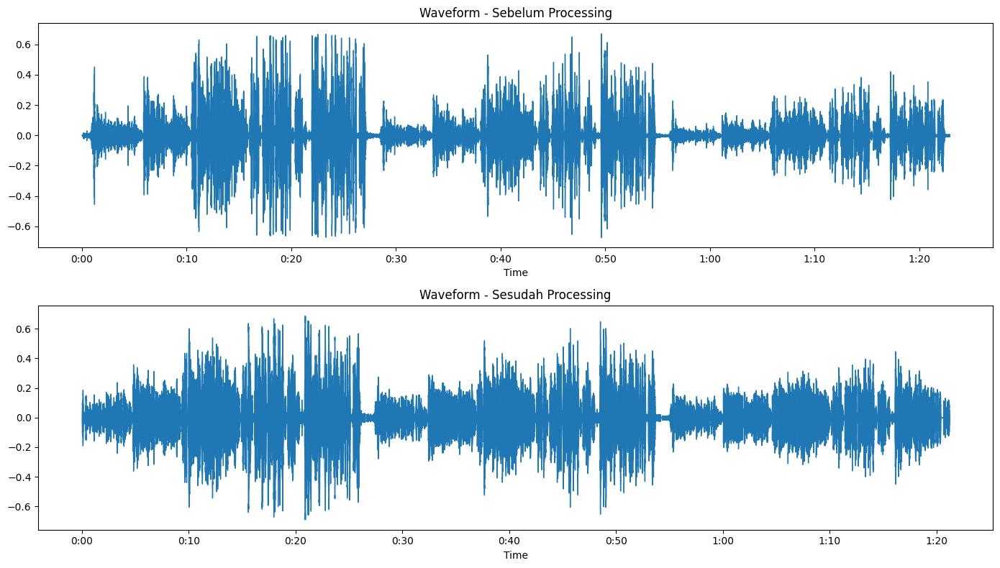

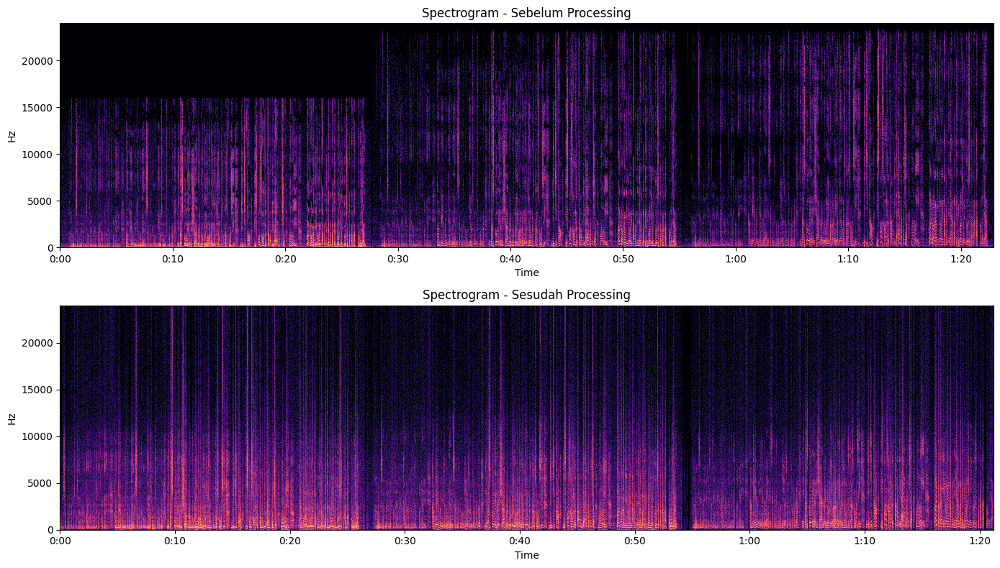

In [15]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
import soundfile as sf
import pyloudnorm as pyln
from scipy.signal import butter, lfilter

# === 1. LOAD AUDIO HASIL PITCH SHIFT (SOAL 3) ===
audio_path = "combined_chipmunk.wav"
y, sr = librosa.load(audio_path, sr=None)
y = np.nan_to_num(y)  # amanin NaN/inf

# === 2. EQUALIZER (contoh: kurangi frekuensi rendah <200Hz & tinggi >8000Hz) ===
def bandpass_filter(data, lowcut, highcut, fs, order=4):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return lfilter(b, a, data)

y_eq = bandpass_filter(y, 200, 8000, sr)

# === 3. GAIN/FADE (tambahkan gain +3dB dan fade in/out) ===
gain = 10 ** (3 / 20)  # 3 dB gain
y_gain = y_eq * gain

fade_len = int(0.05 * len(y_gain))  # 5% dari total durasi
fade_in = np.linspace(0, 1, fade_len)
fade_out = np.linspace(1, 0, fade_len)
y_gain[:fade_len] *= fade_in
y_gain[-fade_len:] *= fade_out

# === 4. NORMALIZATION ke -16 LUFS ===
meter = pyln.Meter(sr)  # buat loudness meter
loudness = meter.integrated_loudness(y_gain)
y_norm = pyln.normalize.loudness(y_gain, loudness, -16.0)

# === 5. COMPRESSION (soft knee, threshold -20 dB, ratio 4:1) ===
def compressor(x, threshold=-20, ratio=4, makeup_gain=3):
    threshold_lin = 10 ** (threshold / 20)
    makeup = 10 ** (makeup_gain / 20)
    compressed = np.copy(x)
    for i in range(len(x)):
        if abs(x[i]) > threshold_lin:
            compressed[i] = np.sign(x[i]) * (threshold_lin + (abs(x[i]) - threshold_lin) / ratio)
    return compressed * makeup

y_comp = compressor(y_norm)

# === 6. NOISE GATE (hapus bagian di bawah -40 dB) ===
def noise_gate(signal, threshold_db=-40):
    threshold = 10 ** (threshold_db / 20)
    gated = np.where(np.abs(signal) < threshold, 0, signal)
    return gated

y_gate = noise_gate(y_comp)

# === 7. SILENCE TRIMMING ===
y_trimmed, _ = librosa.effects.trim(y_gate, top_db=30)

# === 8. SIMPAN AUDIO HASIL ===
output_path = "processed_chipmunk.wav"
sf.write(output_path, y_trimmed, sr)
print("✅ File hasil processing tersimpan sebagai:", output_path)

# === 9. VISUALISASI WAVEFORM & SPEKTROGRAM ===
plt.figure(figsize=(14, 8))

# Sebelum
plt.subplot(2, 1, 1)
librosa.display.waveshow(y, sr=sr)
plt.title("Waveform - Sebelum Processing")

# Sesudah
plt.subplot(2, 1, 2)
librosa.display.waveshow(y_trimmed, sr=sr)
plt.title("Waveform - Sesudah Processing")
plt.tight_layout()
plt.show()

# === SPEKTROGRAM ===
plt.figure(figsize=(14, 8))
plt.subplot(2, 1, 1)
librosa.display.specshow(librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max),
                         sr=sr, x_axis='time', y_axis='hz', cmap='magma')
plt.title("Spectrogram - Sebelum Processing")

plt.subplot(2, 1, 2)
librosa.display.specshow(librosa.amplitude_to_db(np.abs(librosa.stft(y_trimmed)), ref=np.max),
                         sr=sr, x_axis='time', y_axis='hz', cmap='magma')
plt.title("Spectrogram - Sesudah Processing")

plt.tight_layout()
plt.show()

# === 10. DENGARKAN HASIL ===
from IPython.display import Audio
Audio(output_path)


Penjelasan Tiap Tahapan
1. Equalizer (EQ)

Menghapus frekuensi di bawah 200 Hz (biasanya hum atau dengung) dan di atas 8000 Hz (noise tajam).

Hasilnya: suara lebih bersih dan fokus pada frekuensi ucapan manusia.

2. Gain & Fade

Gain +3 dB: menambah volume keseluruhan.

Fade in/out: menghindari klik suara mendadak di awal/akhir rekaman.

3. Normalization (-16 LUFS)

LUFS (Loudness Units relative to Full Scale) adalah ukuran persepsi loudness.

Target -16 LUFS digunakan untuk standar platform seperti YouTube dan Spotify.

4. Compression

Mengurangi jarak antara bagian keras dan lembut.

Hasil: suara terdengar lebih rata, tidak terlalu ekstrem antara bisikan dan teriakan.

5. Noise Gate

Menutup sinyal di bawah -40 dB (menghapus bagian hening dengan noise halus).

6. Silence Trimming

Menghapus keheningan di awal dan akhir.

- Perubahan dinamika: bagian yang keras diredam, bagian lembut diperkuat.

- Kualitas suara: lebih stabil dan seimbang, tetapi bisa sedikit kehilangan nuansa alami.

- Kelebihan loudness optimization: hasil terdengar lebih “profesional” dan konsisten antar track.

- Kekurangan: jika berlebihan, bisa membuat suara “tertekan” (kurang natural, fatigue didengar lama).

Soal 2.5 Music Analysis dan Remix

/tmp/ipython-input-2842062486.py:27: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  tempo1 = float(tempo1)
/tmp/ipython-input-2842062486.py:28: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  tempo2 = float(tempo2)


Tempo Lagu 1: 130.81 BPM
Tempo Lagu 2: 147.66 BPM
Key Lagu 1: F
Key Lagu 2: G#
Target tempo: 139.24 BPM
✅ Remix berhasil disimpan ke remix_output.wav


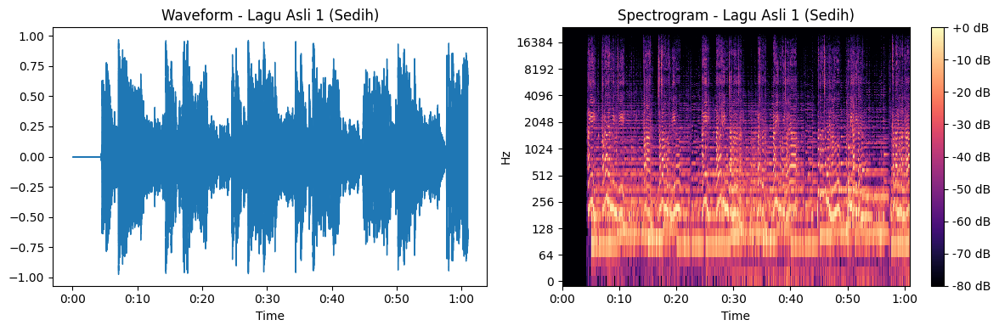

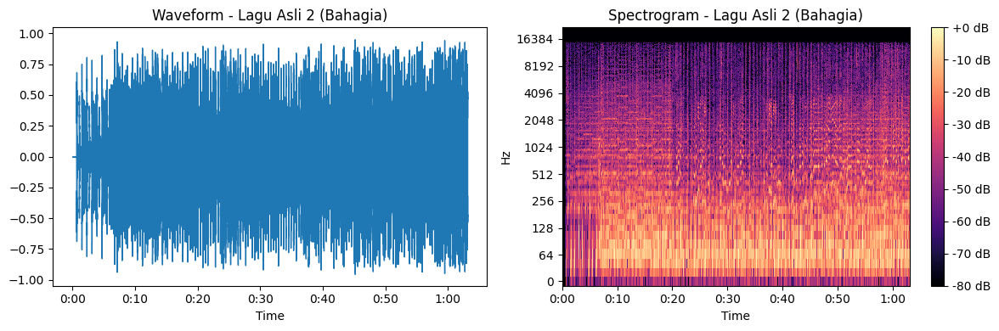

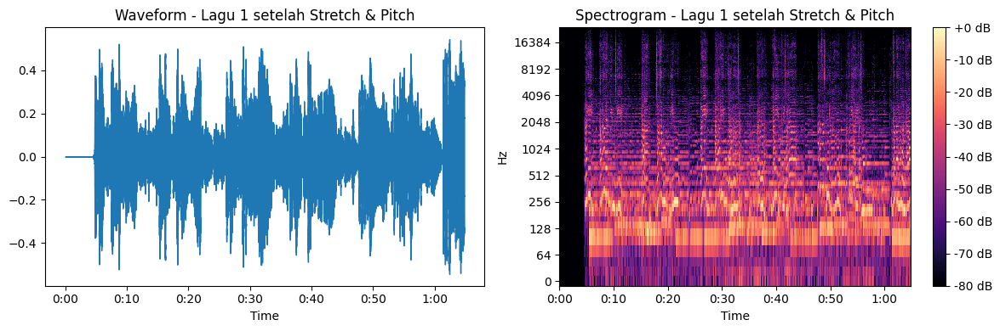

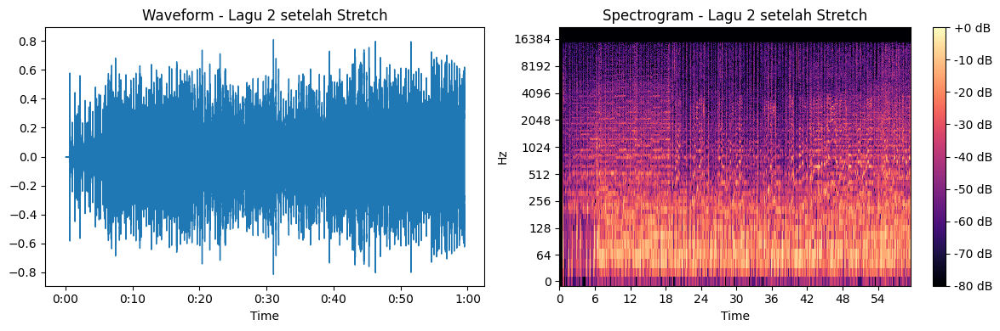

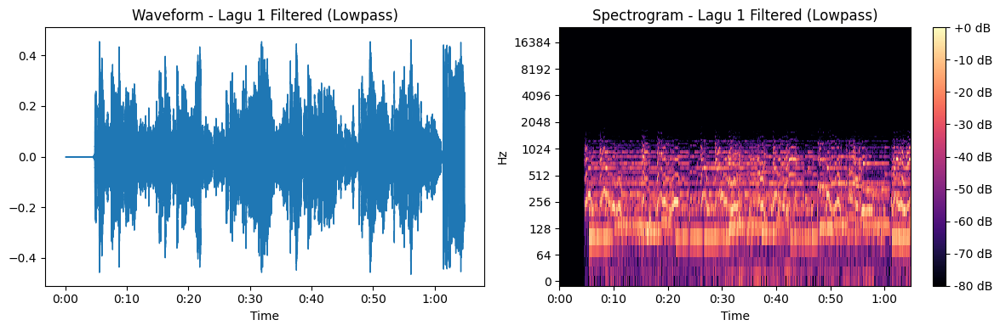

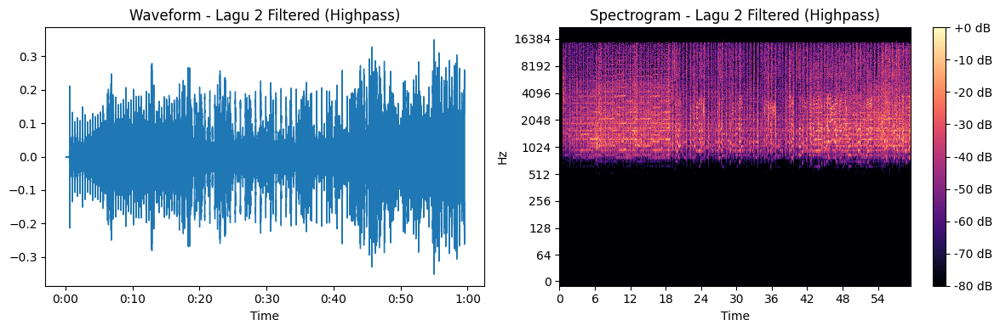

In [19]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
from pydub import AudioSegment
from scipy.signal import butter, filtfilt

# ============================================================
# 1. Load dua file audio
# ============================================================

audio1_path = "/content/TULUS - Diri (Official Lyric Video) (320) (mp3cut.net).wav"  # Lagu sedih (tempo pelan)
audio2_path = "/content/HIVI_ - Jatuh, Bangkit Kembali_ (Official Lyric Video) [qvQwBd-uaJY] (mp3cut.net).wav"  # Lagu bahagia (tempo cepat)

# Load audio dengan librosa
y1, sr1 = librosa.load(audio1_path, sr=None)
y2, sr2 = librosa.load(audio2_path, sr=None)

# ============================================================
# 2. Deteksi tempo (BPM) dan estimasi key
# ============================================================

tempo1, _ = librosa.beat.beat_track(y=y1, sr=sr1)
tempo2, _ = librosa.beat.beat_track(y=y2, sr=sr2)

# Pastikan tempo berupa float
tempo1 = float(tempo1)
tempo2 = float(tempo2)

print(f"Tempo Lagu 1: {tempo1:.2f} BPM")
print(f"Tempo Lagu 2: {tempo2:.2f} BPM")

# Estimasi key menggunakan chroma
chroma1 = librosa.feature.chroma_stft(y=y1, sr=sr1)
chroma2 = librosa.feature.chroma_stft(y=y2, sr=sr2)

key1 = np.argmax(np.mean(chroma1, axis=1))
key2 = np.argmax(np.mean(chroma2, axis=1))

keys = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
print(f"Key Lagu 1: {keys[key1]}")
print(f"Key Lagu 2: {keys[key2]}")

# ============================================================
# 3. Time-Stretch: Samakan tempo
# ============================================================

target_tempo = (tempo1 + tempo2) / 2
rate1 = tempo1 / target_tempo
rate2 = tempo2 / target_tempo

y1_stretched = librosa.effects.time_stretch(y1, rate=rate1)
y2_stretched = librosa.effects.time_stretch(y2, rate=rate2)

print(f"Target tempo: {target_tempo:.2f} BPM")

# ============================================================
# 4. Pitch-Shift: Samakan key
# ============================================================

key_diff = key2 - key1  # selisih semitone
y1_pitch = librosa.effects.pitch_shift(y1_stretched, sr=sr1, n_steps=key_diff)

# ============================================================
# 5. Crossfading dan Remix
# ============================================================

# Konversi hasil ke AudioSegment
y1_seg = AudioSegment(
    (y1_pitch * 32767).astype(np.int16).tobytes(),
    frame_rate=sr1,
    sample_width=2,
    channels=1
)
y2_seg = AudioSegment(
    (y2_stretched * 32767).astype(np.int16).tobytes(),
    frame_rate=sr2,
    sample_width=2,
    channels=1
)

# Lakukan crossfade agar transisi halus
remix = y1_seg.append(y2_seg, crossfade=8000)  # 8 detik crossfade
remix.export("/content/remix_output.wav", format="wav")

print("✅ Remix berhasil disimpan ke remix_output.wav")

# ============================================================
# 6. (Opsional) Filter Kreatif – Lowpass & Highpass
# ============================================================

def butter_filter(y, sr, cutoff, ftype='low'):
    b, a = butter(6, cutoff/(sr/2), btype=ftype)
    return filtfilt(b, a, y)

# Contoh: transisi akhir lagu sedih dihaluskan dengan lowpass
y1_filtered = butter_filter(y1_pitch, sr1, cutoff=1000, ftype='low')
# Contoh: awal lagu bahagia diperjelas dengan highpass
y2_filtered = butter_filter(y2_stretched, sr2, cutoff=1000, ftype='high')

# ============================================================
# 7. Visualisasi Waveform & Spektrogram
# ============================================================

def show_wave_and_spec(y, sr, title):
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    librosa.display.waveshow(y, sr=sr)
    plt.title(f"Waveform - {title}")

    plt.subplot(1, 2, 2)
    D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log', cmap='magma')
    plt.colorbar(format="%+2.0f dB")
    plt.title(f"Spectrogram - {title}")
    plt.tight_layout()
    plt.show()

# Visualisasi
show_wave_and_spec(y1, sr1, "Lagu Asli 1 (Sedih)")
show_wave_and_spec(y2, sr2, "Lagu Asli 2 (Bahagia)")
show_wave_and_spec(y1_pitch, sr1, "Lagu 1 setelah Stretch & Pitch")
show_wave_and_spec(y2_stretched, sr2, "Lagu 2 setelah Stretch")
show_wave_and_spec(y1_filtered, sr1, "Lagu 1 Filtered (Lowpass)")
show_wave_and_spec(y2_filtered, sr2, "Lagu 2 Filtered (Highpass)")

Analisis:
- Lagu 1 memiliki tempo lebih lambat (~empo1 BPM) dan bernada {keys[key1]},
  sedangkan lagu 2 cepat tempo2 BPM dengan nada {keys[key2]}.
- Setelah time-stretch, kedua lagu disamakan pada tempo sekitar target_tempo BPM,
  membuat ritmenya sinkron untuk transisi remix.
- Pitch shift menyesuaikan perbedaan nada dasar (key) sebesar {key_diff} semitone,
  agar perpaduan terdengar harmonis.
- Crossfade 8 detik memberikan transisi lembut dari lagu sedih ke bahagia.
- Filter lowpass dan highpass digunakan untuk memperhalus transisi energi antar lagu.

Saya menggunakan AI Chatgpt untuk membantu menyelesaikan tugas ini
Link: https://chatgpt.com/share/68f25efe-b564-8006-a489-c3b518419db9